In [ ]:
# Cell 1: Training Script Using Only Your .txt Descriptions

# 1. Install required libraries
!pip install -q diffusers transformers accelerate safetensors bitsandbytes peft

# 2. Mount Google Drive (force remount)
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# 3. Configuration
import os
dataset_path   = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/processed_pics"
output_dir     = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset"
epochs         = 50
batch_size     = 2
learning_rate  = 5e-5
os.makedirs(output_dir, exist_ok=True)

# 4. Imports
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms

from diffusers import UNet2DConditionModel, AutoencoderKL, DPMSolverMultistepScheduler
from transformers import CLIPTextModel, CLIPTokenizer
from peft import LoraConfig, get_peft_model
from accelerate import Accelerator

# 5. Load tokenizer & text encoder (no extra token)
model_name    = "runwayml/stable-diffusion-v1-5"
tokenizer     = CLIPTokenizer.from_pretrained(model_name, subfolder="tokenizer")
text_encoder  = CLIPTextModel.from_pretrained(model_name, subfolder="text_encoder")

# 6. Load VAE and UNet
vae  = AutoencoderKL.from_pretrained(model_name, subfolder="vae")
unet = UNet2DConditionModel.from_pretrained(model_name, subfolder="unet")

# 7. Apply LoRA to UNet & Text Encoder
unet_config = LoraConfig(
    r=16, lora_alpha=32,
    target_modules=["to_q","to_k","to_v"],
    lora_dropout=0.05, bias="none"
)
unet = get_peft_model(unet, unet_config)

text_config = LoraConfig(
    r=16, lora_alpha=32,
    target_modules=["q_proj","k_proj","v_proj"],
    lora_dropout=0.05, bias="none"
)
text_encoder = get_peft_model(text_encoder, text_config)

# 8. Scheduler & Accelerator
noise_scheduler = DPMSolverMultistepScheduler.from_pretrained(model_name, subfolder="scheduler")
accelerator     = Accelerator()
device          = accelerator.device

unet.to(device)
text_encoder.to(device)
vae.to(device)

# 9. Dataset: use only original .txt captions
class ImageTextDataset(Dataset):
    def __init__(self, folder, tokenizer, image_transform):
        self.image_paths = [
            os.path.join(folder, f)
            for f in os.listdir(folder)
            if f.lower().endswith(('png','jpg','jpeg'))
        ]
        self.tokenizer = tokenizer
        self.transform = image_transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        txt_path = os.path.splitext(img_path)[0] + ".txt"
        with open(txt_path, 'r', encoding='utf-8') as f:
            caption = f.read().strip()

        image = Image.open(img_path).convert("RGB")
        pixel_values = self.transform(image)

        tokens = self.tokenizer(
            caption,
            padding="max_length",
            truncation=True,
            max_length=self.tokenizer.model_max_length,
            return_tensors="pt"
        )
        return {
            "pixel_values":    pixel_values,
            "input_ids":       tokens.input_ids[0],
            "attention_mask":  tokens.attention_mask[0]
        }

# 10. Prepare DataLoader
image_transform = transforms.Compose([
    transforms.Resize((512,512)),
    transforms.ToTensor(),
    transforms.Normalize([0.5],[0.5])
])

dataset    = ImageTextDataset(dataset_path, tokenizer, image_transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

# 11. Optimizer
optimizer = torch.optim.AdamW(
    list(unet.parameters()) + list(text_encoder.parameters()),
    lr=learning_rate
)

# 12. Training loop
for epoch in range(1, epochs+1):
    unet.train(); text_encoder.train()
    for batch in dataloader:
        optimizer.zero_grad()

        # encode images to latents
        pv = batch["pixel_values"].to(device)
        latents = vae.encode(pv).latent_dist.sample() * 0.18215

        # add noise
        noise = torch.randn_like(latents)
        timesteps = torch.randint(
            0, noise_scheduler.config.num_train_timesteps,
            (latents.shape[0],), device=device
        )
        noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

        # text embeddings
        out = text_encoder(
            input_ids=batch["input_ids"].to(device),
            attention_mask=batch["attention_mask"].to(device)
        )
        txt_embeds = out.last_hidden_state

        # predict & compute loss
        pred = unet(noisy_latents, timesteps, encoder_hidden_states=txt_embeds).sample
        loss = torch.nn.functional.mse_loss(pred, noise)
        accelerator.backward(loss)
        optimizer.step()

    # Save adapters into separate subfolders
    ckpt_folder = os.path.join(output_dir, f"lora_sd15_ckpt_epoch_{epoch}")
    os.makedirs(os.path.join(ckpt_folder, "unet_lora"), exist_ok=True)
    os.makedirs(os.path.join(ckpt_folder, "text_lora"), exist_ok=True)
    unet.save_pretrained(os.path.join(ckpt_folder, "unet_lora"))
    text_encoder.save_pretrained(os.path.join(ckpt_folder, "text_lora"))
    print(f"Epoch {epoch} complete — adapters saved in {ckpt_folder}")

# 13. Save final adapters
final_unet = os.path.join(output_dir, "final_unet_lora")
final_text = os.path.join(output_dir, "final_text_lora")
os.makedirs(final_unet, exist_ok=True)
os.makedirs(final_text, exist_ok=True)
unet.save_pretrained(final_unet)
text_encoder.save_pretrained(final_text)
print("Training complete. Final adapters saved.")


Mounted at /content/drive


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Epoch 1 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_1
Epoch 2 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_2
Epoch 3 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_3
Epoch 4 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_4
Epoch 5 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_5
Epoch 6 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_6
Epoch 7 complete — adapters saved in /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/lora_sd15_ckpt_epoch_7
Epoch 8 compl

Mounted at /content/drive


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

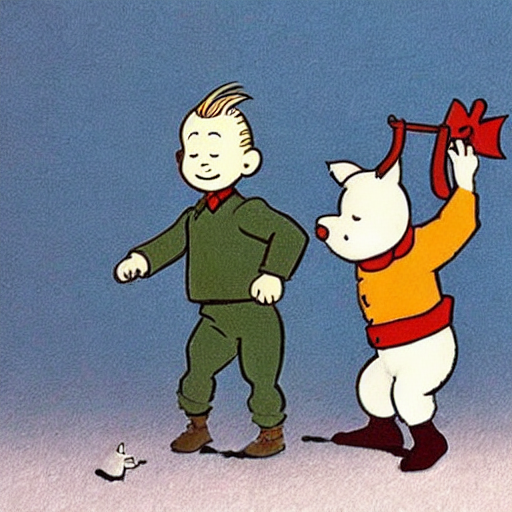

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_1/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch1_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

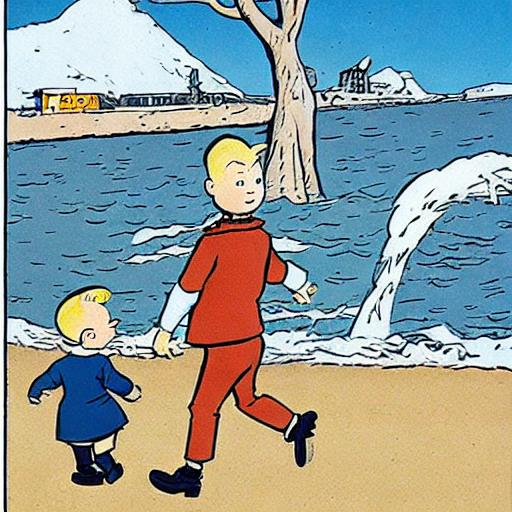

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_1/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch1_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

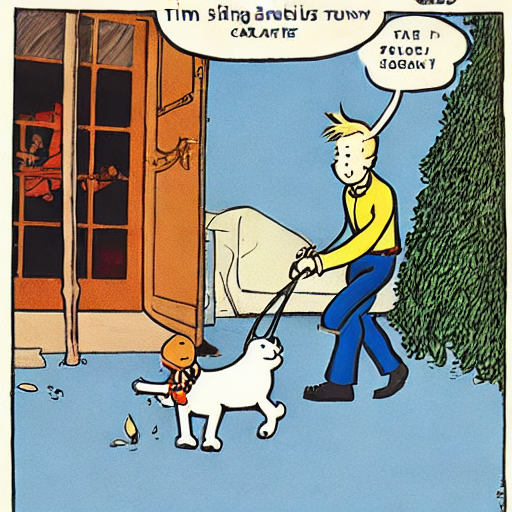

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_2/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch2_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

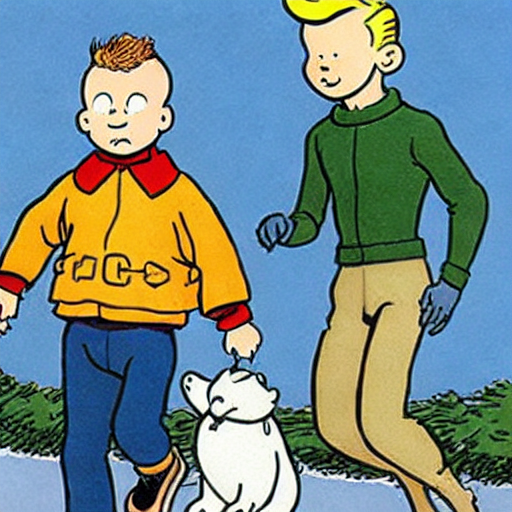

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_2/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch2_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

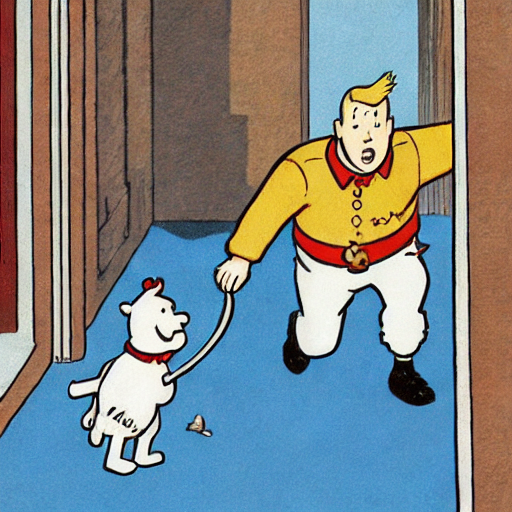

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_3/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch3_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

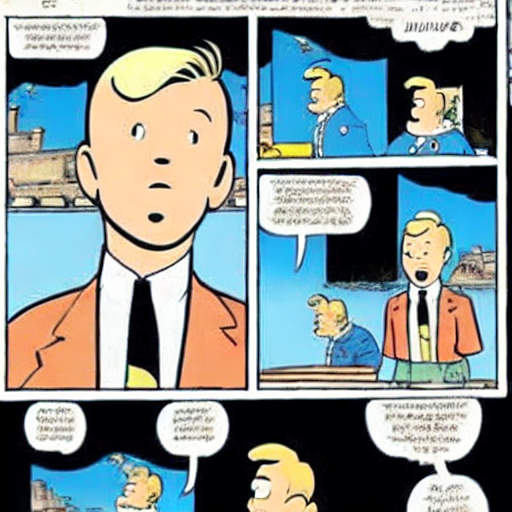

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_3/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch3_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

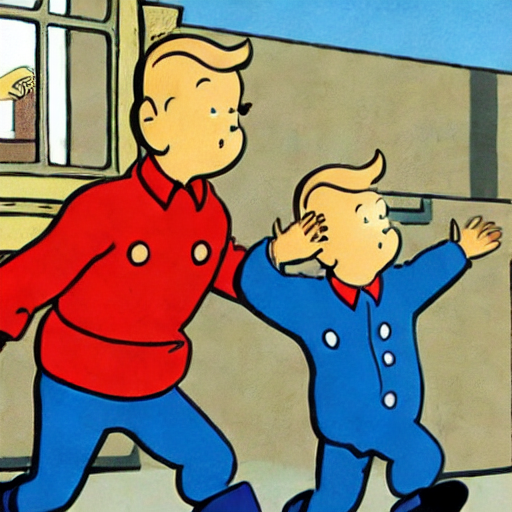

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_4/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch4_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

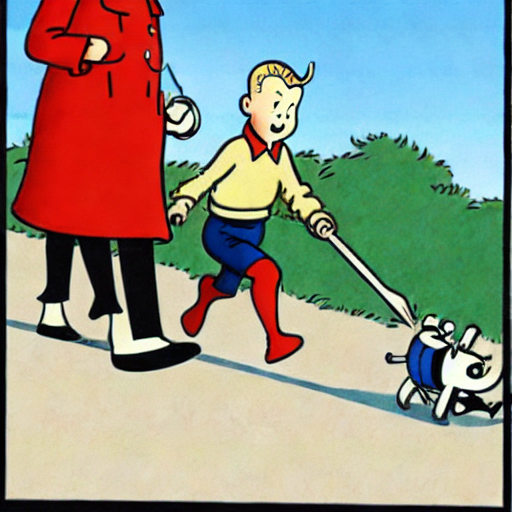

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_4/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch4_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

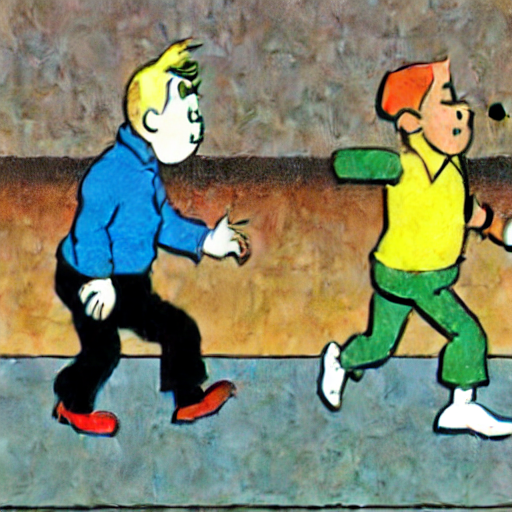

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_5/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch5_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

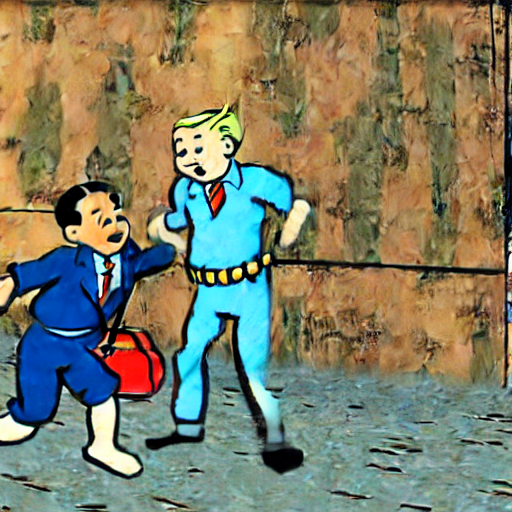

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_5/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch5_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

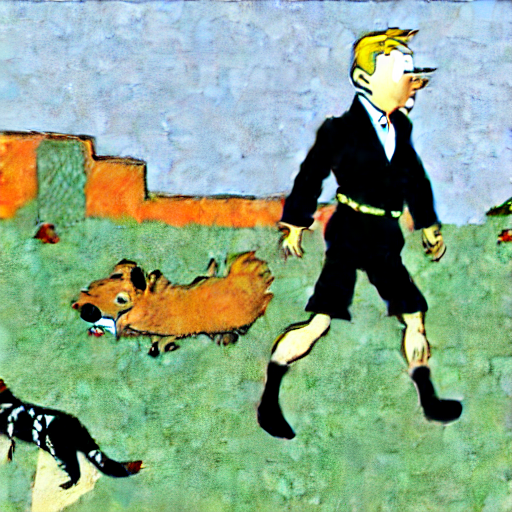

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_6/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch6_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

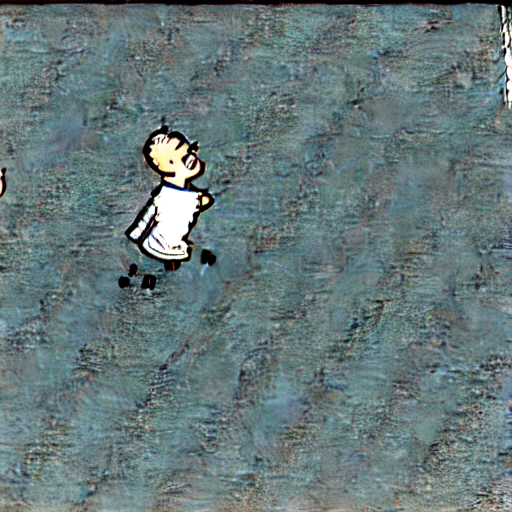

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_ckpt_epoch_6/tintin_and_snowy_walking_In_tintin_style_lign_claire_herg_epoch6_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [3]:
# Cell 2: Generate & Display Samples (no style token)

# 1. Mount Google Drive (if not already)
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# 2. Configuration
import os, re, torch
from diffusers import StableDiffusionPipeline
from peft import PeftModel
from IPython.display import display

output_dir = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset"
epochs     = 50
device     = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 3. Your prompt without the <tintin> token
prompt = "tintin and snowy walking, In tintin style, ligné claire, hergé"
guidance_scale = 9

# sanitize for filesystem
dir_prompt = re.sub(r'[^A-Za-z0-9]+', '_', prompt).strip('_')

for epoch in range(1, epochs + 1):
    base_ckpt = os.path.join(output_dir, f"lora_sd15_ckpt_epoch_{epoch}")
    unet_dir  = os.path.join(base_ckpt, "unet_lora")
    text_dir  = os.path.join(base_ckpt, "text_lora")

    # Load base pipeline
    pipe = StableDiffusionPipeline.from_pretrained(
        "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16
    ).to(device)

    # Inject your LoRA adapters
    pipe.unet         = PeftModel.from_pretrained(pipe.unet,        unet_dir,  is_trainable=False)
    pipe.text_encoder = PeftModel.from_pretrained(pipe.text_encoder, text_dir, is_trainable=False)

    # Prepare save directory
    save_dir = os.path.join(output_dir, f"{dir_prompt}_ckpt_epoch_{epoch}")
    os.makedirs(save_dir, exist_ok=True)

    # Generate, save, and display two images
    for i in range(1, 3):
        img = pipe(prompt, guidance_scale=guidance_scale).images[0]
        display(img)
        fname = f"{dir_prompt}_epoch{epoch}_{i}.png"
        path  = os.path.join(save_dir, fname)
        img.save(path)
        print(f"✔ Saved: {path}")


Mounted at /content/drive


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

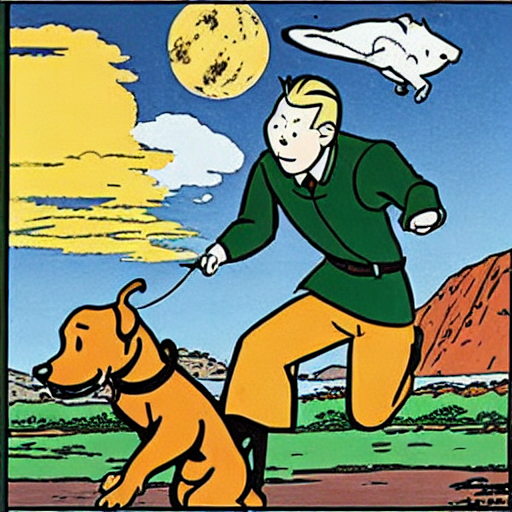

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

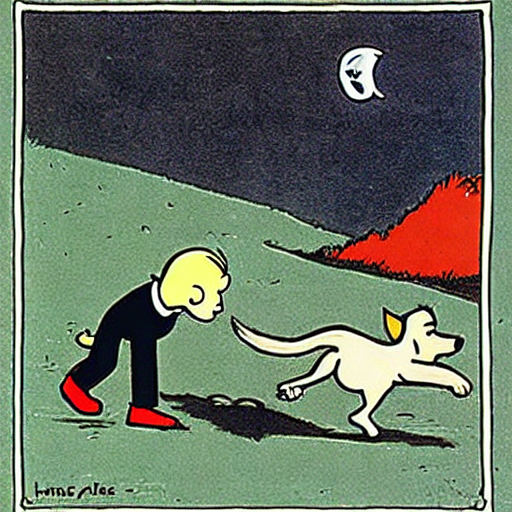

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_2.png


  0%|          | 0/50 [00:00<?, ?it/s]

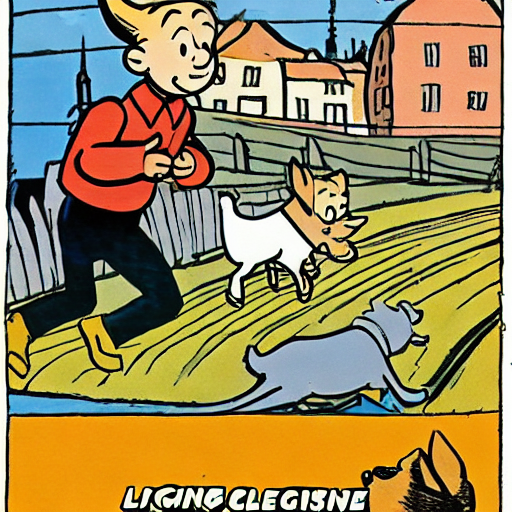

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_3.png


  0%|          | 0/50 [00:00<?, ?it/s]

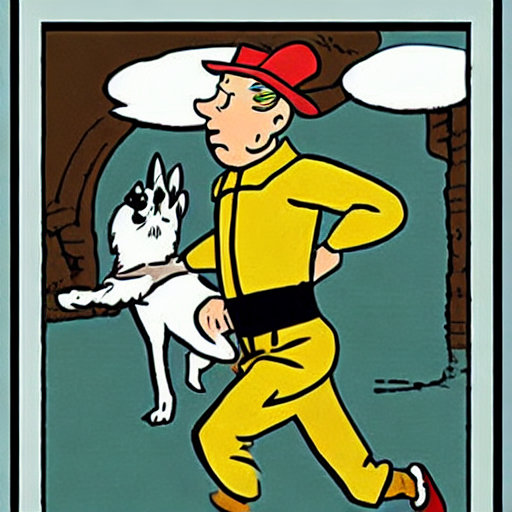

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_4.png


  0%|          | 0/50 [00:00<?, ?it/s]

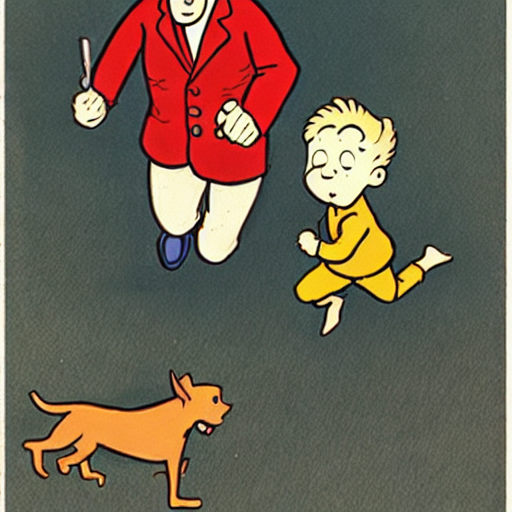

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_5.png


  0%|          | 0/50 [00:00<?, ?it/s]

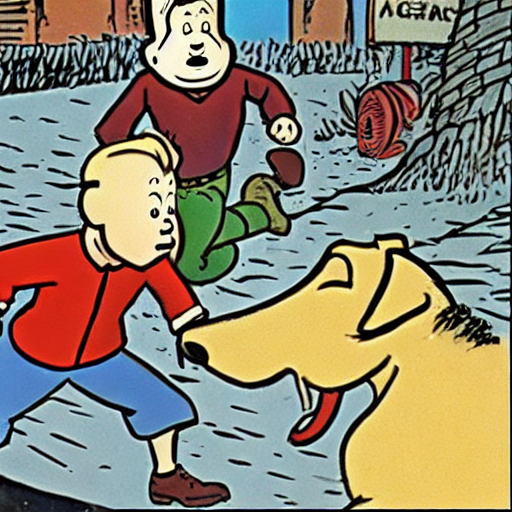

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_6.png


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


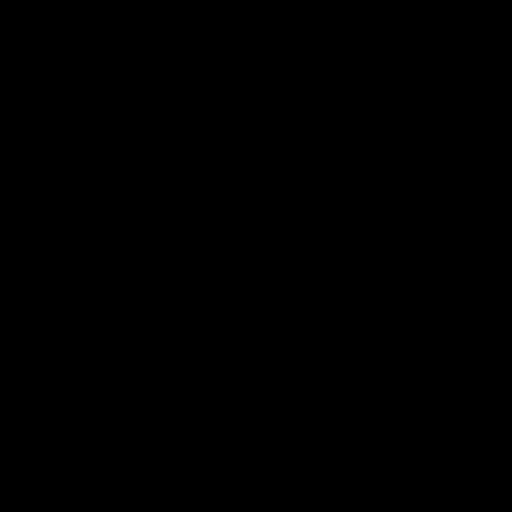

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_7.png


  0%|          | 0/50 [00:00<?, ?it/s]

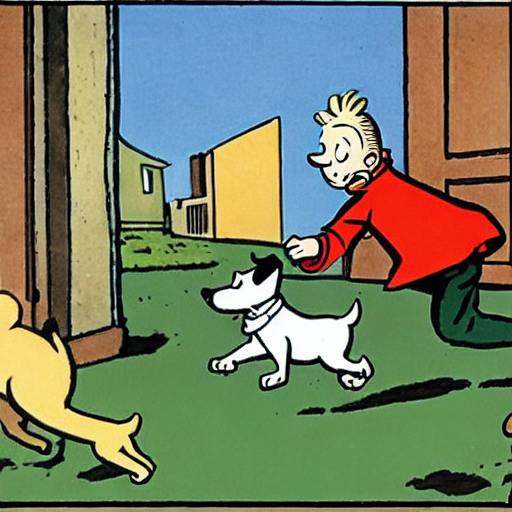

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_8.png


  0%|          | 0/50 [00:00<?, ?it/s]

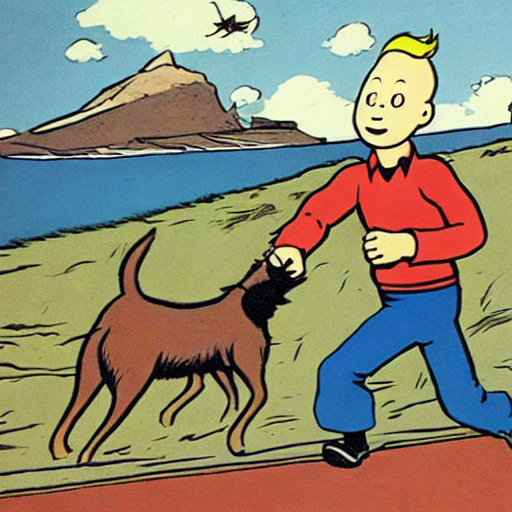

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_9.png


  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


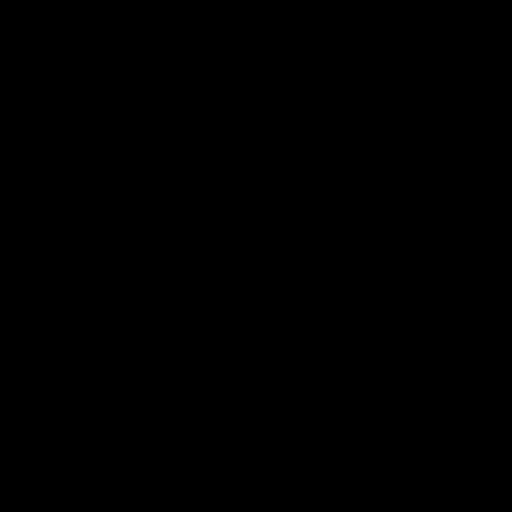

✔ Saved: /content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15/man_chasing_dog_In_tintin_style_lign_claire_herg_sd15_10.png


In [2]:
# 1. Mount Google Drive (if not already)
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# 2. Configuration
import os, re, torch
from diffusers import StableDiffusionPipeline
from IPython.display import display

output_dir = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sd15_output_small_dataset"
os.makedirs(output_dir, exist_ok=True)

epochs     = 50       # you can leave this or remove entirely; it's unused below
device     = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 3. Your prompt without the <tintin> token
prompt = "man chasing dog, In tintin style, ligné claire, hergé"
guidance_scale = 9

# sanitize for filesystem
dir_prompt = re.sub(r'[^A-Za-z0-9]+', '_', prompt).strip('_')

# 4. Load the **standard** SD-1.5 pipeline
pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to(device)

# 5. Generate and save 10 images
save_dir = os.path.join(output_dir, f"{dir_prompt}_sd15")
os.makedirs(save_dir, exist_ok=True)

for i in range(1, 11):
    img = pipe(prompt, guidance_scale=guidance_scale).images[0]
    display(img)
    fname = f"{dir_prompt}_sd15_{i}.png"
    path  = os.path.join(save_dir, fname)
    img.save(path)
    print(f"✔ Saved: {path}")


In [2]:
# Cell 1: Training Script Using Only Your .txt Descriptions with SDXL

# 1. Install required libraries
!pip install -q diffusers transformers accelerate safetensors bitsandbytes peft

# 2. Mount Google Drive (force remount)
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# 3. Configuration
import os
import torch

dataset_path   = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/processed_pics"
output_dir     = "/content/drive/MyDrive/Studium/Semester 2025/CVAI/lora_sdxl_output_small_dataset"
epochs         = 50
batch_size     = 1  # Reduced due to SDXL's larger memory requirements
learning_rate  = 1e-5  # Slightly lower learning rate for SDXL
torch_dtype    = torch.float16  # Use float16 precision to save memory
os.makedirs(output_dir, exist_ok=True)

# 4. Imports
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms

from diffusers import UNet2DConditionModel, AutoencoderKL, DPMSolverMultistepScheduler
from transformers import CLIPTextModel, CLIPTokenizer, CLIPTextModelWithProjection
from peft import LoraConfig, get_peft_model
from accelerate import Accelerator

# 5. Load tokenizer & text encoders (SDXL has two)
model_name = "stabilityai/stable-diffusion-xl-base-1.0"

# First text encoder setup (CLIP ViT-L/14)
tokenizer_one = CLIPTokenizer.from_pretrained(model_name, subfolder="tokenizer")
text_encoder_one = CLIPTextModel.from_pretrained(
    model_name,
    subfolder="text_encoder",
    torch_dtype=torch.float16
)

# Second text encoder setup (CLIP ViT-G/14)
tokenizer_two = CLIPTokenizer.from_pretrained(model_name, subfolder="tokenizer_2")
text_encoder_two = CLIPTextModelWithProjection.from_pretrained(
    model_name,
    subfolder="text_encoder_2",
    torch_dtype=torch.float16
)

# 6. Load VAE and UNet for SDXL
vae = AutoencoderKL.from_pretrained(
    model_name,
    subfolder="vae",
    torch_dtype=torch.float16
)
unet = UNet2DConditionModel.from_pretrained(
    model_name,
    subfolder="unet",
    torch_dtype=torch.float16
)

# 7. Apply LoRA to UNet & Text Encoders
unet_target_modules = [
    "to_q", "to_k", "to_v", "to_out.0",
    "processor.to_out.0"  # Additional processor modules for SDXL
]

unet_config = LoraConfig(
    r=16, lora_alpha=32,
    target_modules=unet_target_modules,
    lora_dropout=0.05, bias="none"
)
unet = get_peft_model(unet, unet_config)

# Apply LoRA to first text encoder
text_config_one = LoraConfig(
    r=16, lora_alpha=32,
    target_modules=["q_proj", "k_proj", "v_proj", "out_proj"],
    lora_dropout=0.05, bias="none"
)
text_encoder_one = get_peft_model(text_encoder_one, text_config_one)

# Apply LoRA to second text encoder
text_config_two = LoraConfig(
    r=16, lora_alpha=32,
    target_modules=["q_proj", "k_proj", "v_proj", "out_proj"],
    lora_dropout=0.05, bias="none"
)
text_encoder_two = get_peft_model(text_encoder_two, text_config_two)

# 8. Scheduler & Accelerator
noise_scheduler = DPMSolverMultistepScheduler.from_pretrained(model_name, subfolder="scheduler")
accelerator = Accelerator()
device = accelerator.device

unet.to(device)
text_encoder_one.to(device)
text_encoder_two.to(device)
vae.to(device)

# 9. Dataset: use only original .txt captions
class ImageTextDataset(Dataset):
    def __init__(self, folder, tokenizer_one, tokenizer_two, image_transform):
        self.image_paths = [
            os.path.join(folder, f)
            for f in os.listdir(folder)
            if f.lower().endswith(('png','jpg','jpeg'))
        ]
        self.tokenizer_one = tokenizer_one
        self.tokenizer_two = tokenizer_two
        self.transform = image_transform
        self.original_size = (1024, 1024)  # Original size of training images
        self.crop_size = (1024, 1024)      # Size after cropping

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        txt_path = os.path.splitext(img_path)[0] + ".txt"
        with open(txt_path, 'r', encoding='utf-8') as f:
            caption = f.read().strip()

        image = Image.open(img_path).convert("RGB")
        pixel_values = self.transform(image)

        # SDXL time_ids
        # Original size, target size, crop coordinates top, crop coordinates left
        time_ids = torch.tensor([
            self.original_size[0], self.original_size[1],
            self.crop_size[0], self.crop_size[1],
            0, 0
        ])

        # Tokenize with first tokenizer
        tokens_one = self.tokenizer_one(
            caption,
            padding="max_length",
            truncation=True,
            max_length=self.tokenizer_one.model_max_length,
            return_tensors="pt"
        )

        # Tokenize with second tokenizer
        tokens_two = self.tokenizer_two(
            caption,
            padding="max_length",
            truncation=True,
            max_length=self.tokenizer_two.model_max_length,
            return_tensors="pt"
        )

        return {
            "pixel_values": pixel_values,
            "input_ids_one": tokens_one.input_ids[0],
            "attention_mask_one": tokens_one.attention_mask[0],
            "input_ids_two": tokens_two.input_ids[0],
            "attention_mask_two": tokens_two.attention_mask[0],
            "time_ids": time_ids
        }

# 10. Prepare DataLoader - SDXL uses 1024x1024 resolution
image_transform = transforms.Compose([
    transforms.Resize((1024, 1024), interpolation=transforms.InterpolationMode.BILINEAR),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

dataset = ImageTextDataset(dataset_path, tokenizer_one, tokenizer_two, image_transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

# 11. Optimizer
optimizer = torch.optim.AdamW(
    list(unet.parameters()) +
    list(text_encoder_one.parameters()) +
    list(text_encoder_two.parameters()),
    lr=learning_rate
)

# 12. Training loop with SDXL's dual text encoders
for epoch in range(1, epochs+1):
    unet.train()
    text_encoder_one.train()
    text_encoder_two.train()

    for batch in dataloader:
        optimizer.zero_grad()

        # encode images to latents
        pv = batch["pixel_values"].to(device, dtype=torch_dtype)
        with torch.no_grad():
            latents = vae.encode(pv).latent_dist.sample() * 0.13025  # Different scaling factor for SDXL

        # add noise
        noise = torch.randn_like(latents)
        timesteps = torch.randint(
            0, noise_scheduler.config.num_train_timesteps,
            (latents.shape[0],), device=device
        )
        noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

        # Get text embeddings from both encoders
        with torch.no_grad():
            # First text encoder
            encoder_one_out = text_encoder_one(
                input_ids=batch["input_ids_one"].to(device),
                attention_mask=batch["attention_mask_one"].to(device)
            )
            prompt_embeds = encoder_one_out.last_hidden_state

            # Second text encoder with projection
            encoder_two_out = text_encoder_two(
                input_ids=batch["input_ids_two"].to(device),
                attention_mask=batch["attention_mask_two"].to(device)
            )
            pooled_prompt_embeds = encoder_two_out.text_embeds

        # Prepare time_ids for SDXL (original size, crop size, crop coordinates)
        time_ids = batch["time_ids"].to(device, dtype=torch_dtype).reshape(batch_size, -1)  # Reshape properly

        # Concatenate the embeddings as expected by SDXL UNet
        added_cond_kwargs = {
            "text_embeds": pooled_prompt_embeds,
            "time_ids": time_ids
        }

        # predict & compute loss
        pred = unet(
            noisy_latents,
            timesteps,
            encoder_hidden_states=prompt_embeds,
            added_cond_kwargs=added_cond_kwargs
        ).sample

        loss = torch.nn.functional.mse_loss(pred, noise)
        accelerator.backward(loss)
        optimizer.step()

    # Save adapters into separate subfolders
    ckpt_folder = os.path.join(output_dir, f"lora_sdxl_ckpt_epoch_{epoch}")
    os.makedirs(os.path.join(ckpt_folder, "unet_lora"), exist_ok=True)
    os.makedirs(os.path.join(ckpt_folder, "text_encoder_one_lora"), exist_ok=True)
    os.makedirs(os.path.join(ckpt_folder, "text_encoder_two_lora"), exist_ok=True)

    unet.save_pretrained(os.path.join(ckpt_folder, "unet_lora"))
    text_encoder_one.save_pretrained(os.path.join(ckpt_folder, "text_encoder_one_lora"))
    text_encoder_two.save_pretrained(os.path.join(ckpt_folder, "text_encoder_two_lora"))

    print(f"Epoch {epoch} complete — adapters saved in {ckpt_folder}")

# 13. Save final adapters
final_unet = os.path.join(output_dir, "final_unet_lora")
final_text_one = os.path.join(output_dir, "final_text_encoder_one_lora")
final_text_two = os.path.join(output_dir, "final_text_encoder_two_lora")

os.makedirs(final_unet, exist_ok=True)
os.makedirs(final_text_one, exist_ok=True)
os.makedirs(final_text_two, exist_ok=True)

unet.save_pretrained(final_unet)
text_encoder_one.save_pretrained(final_text_one)
text_encoder_two.save_pretrained(final_text_two)

print("Training complete. Final adapters saved.")

Mounted at /content/drive


RuntimeError: mat1 and mat2 shapes cannot be multiplied (77x768 and 2048x640)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

SDXL Inference ready on cuda
Enter prompt (or 'exit' to quit): tintin and snowy walking, ligne claire, herge


  0%|          | 0/50 [00:00<?, ?it/s]

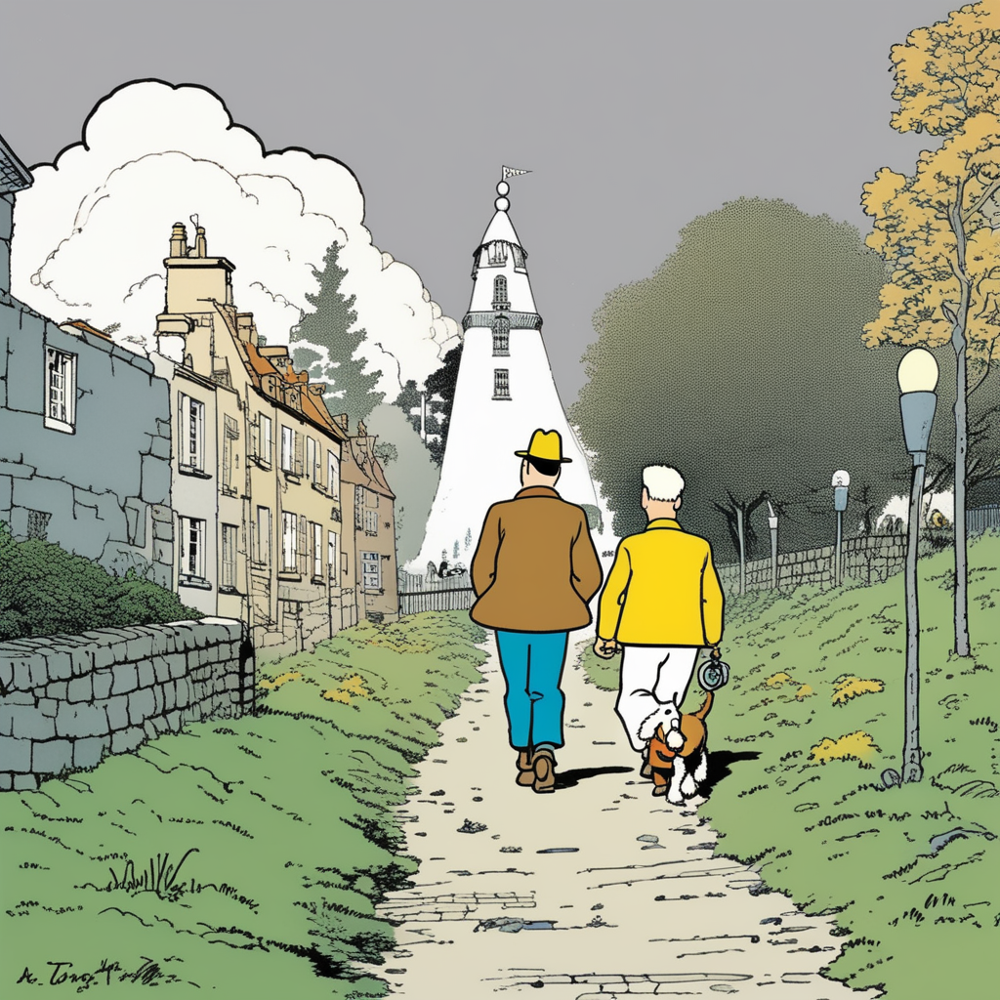

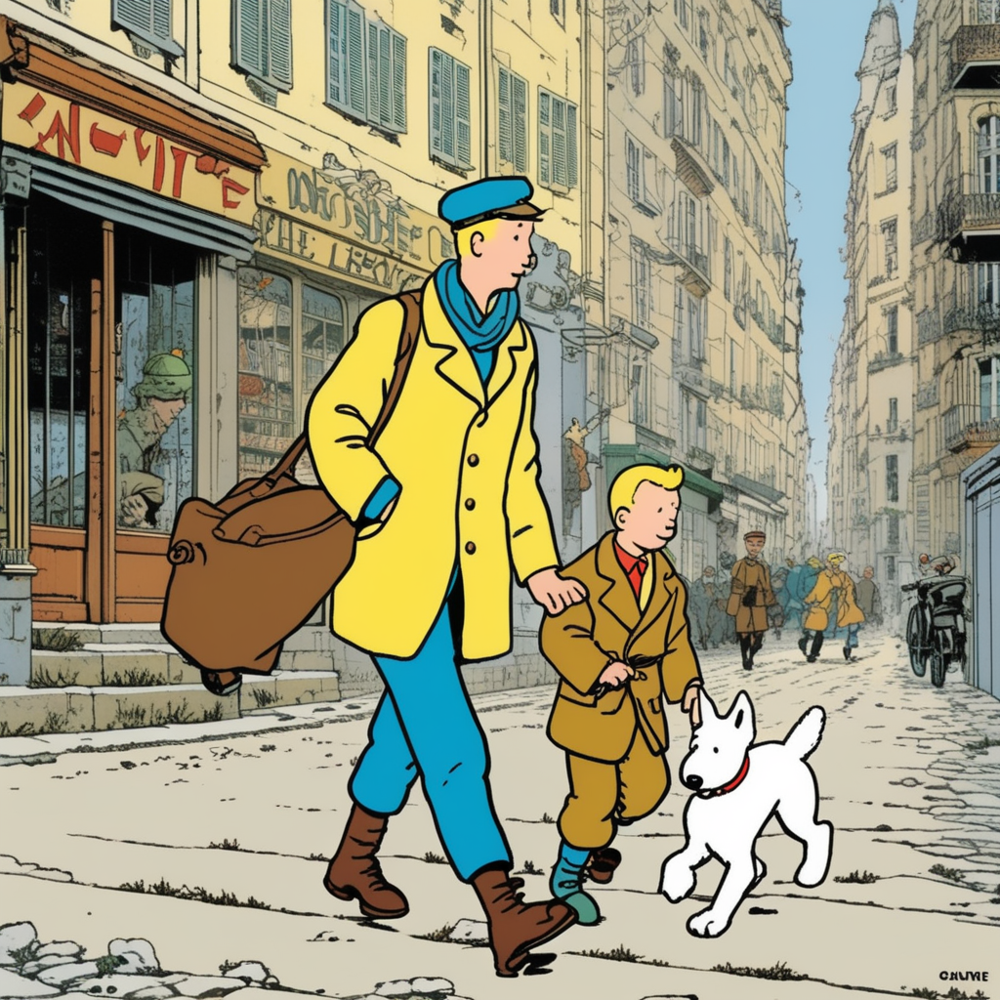

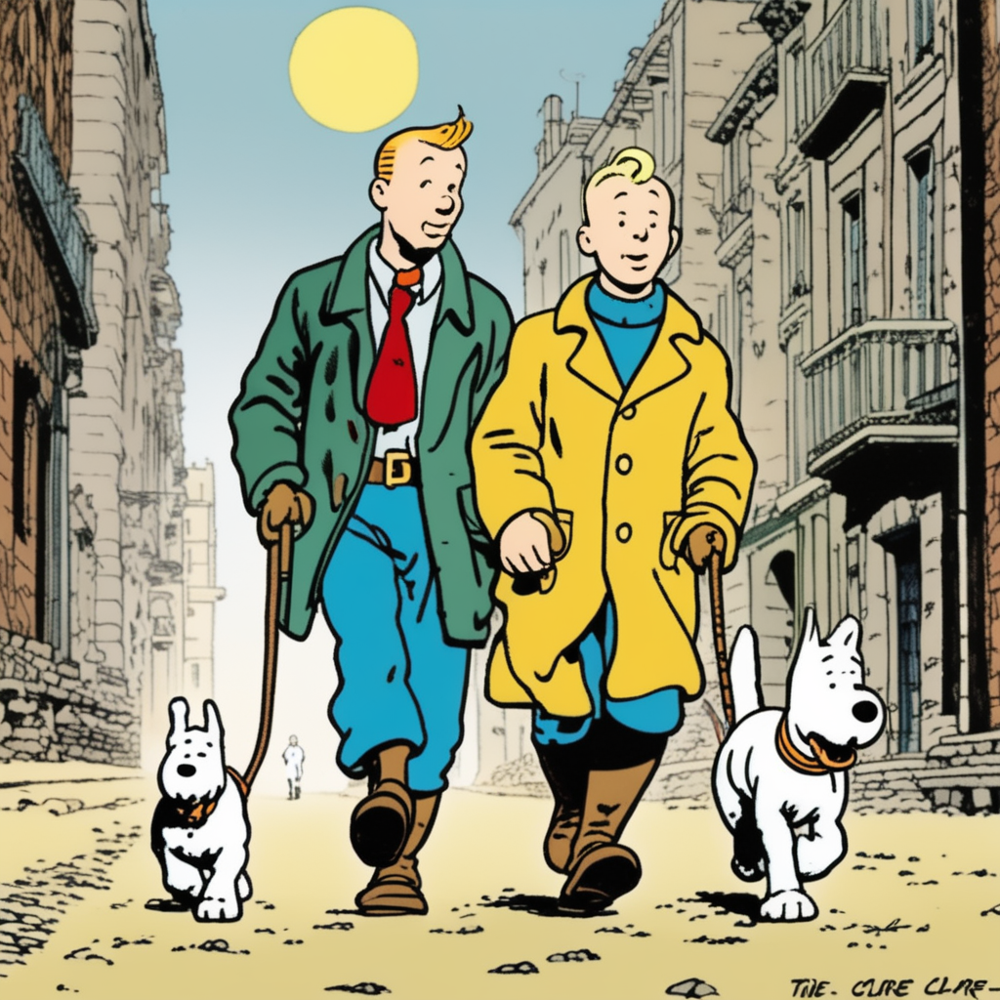

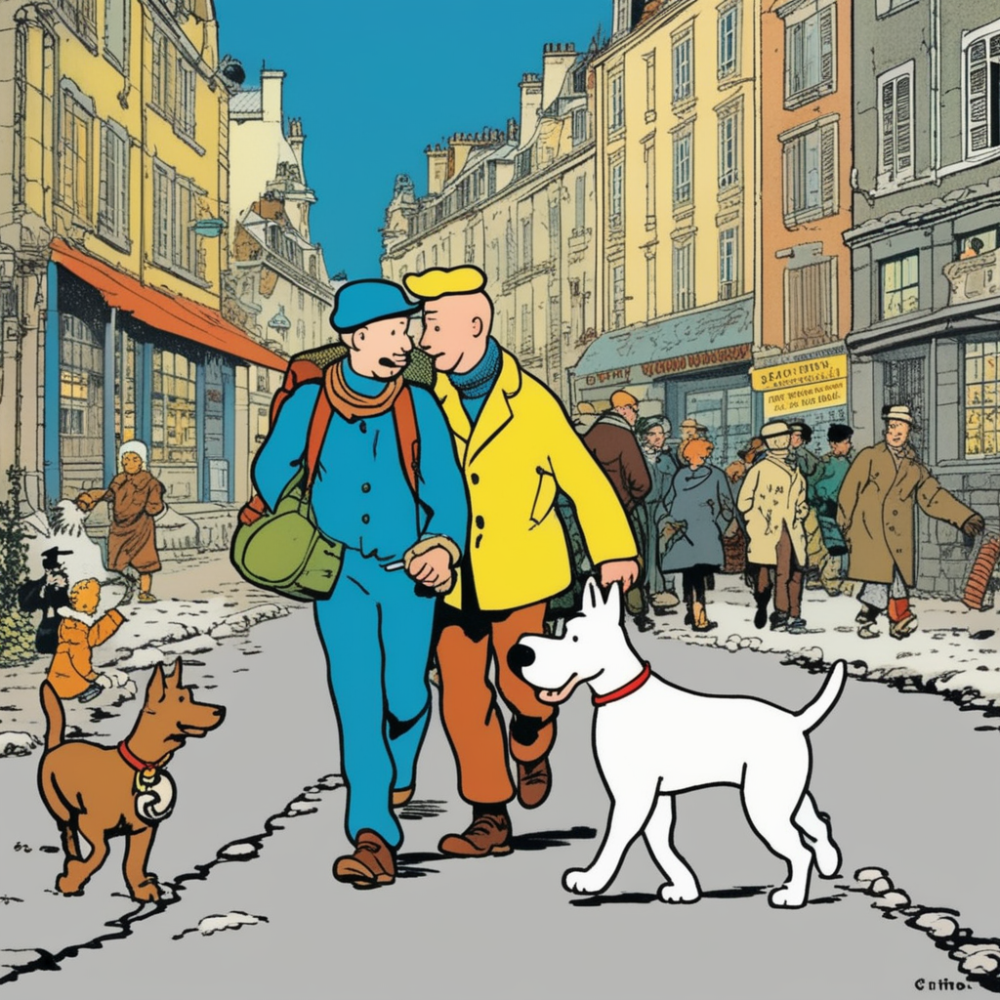

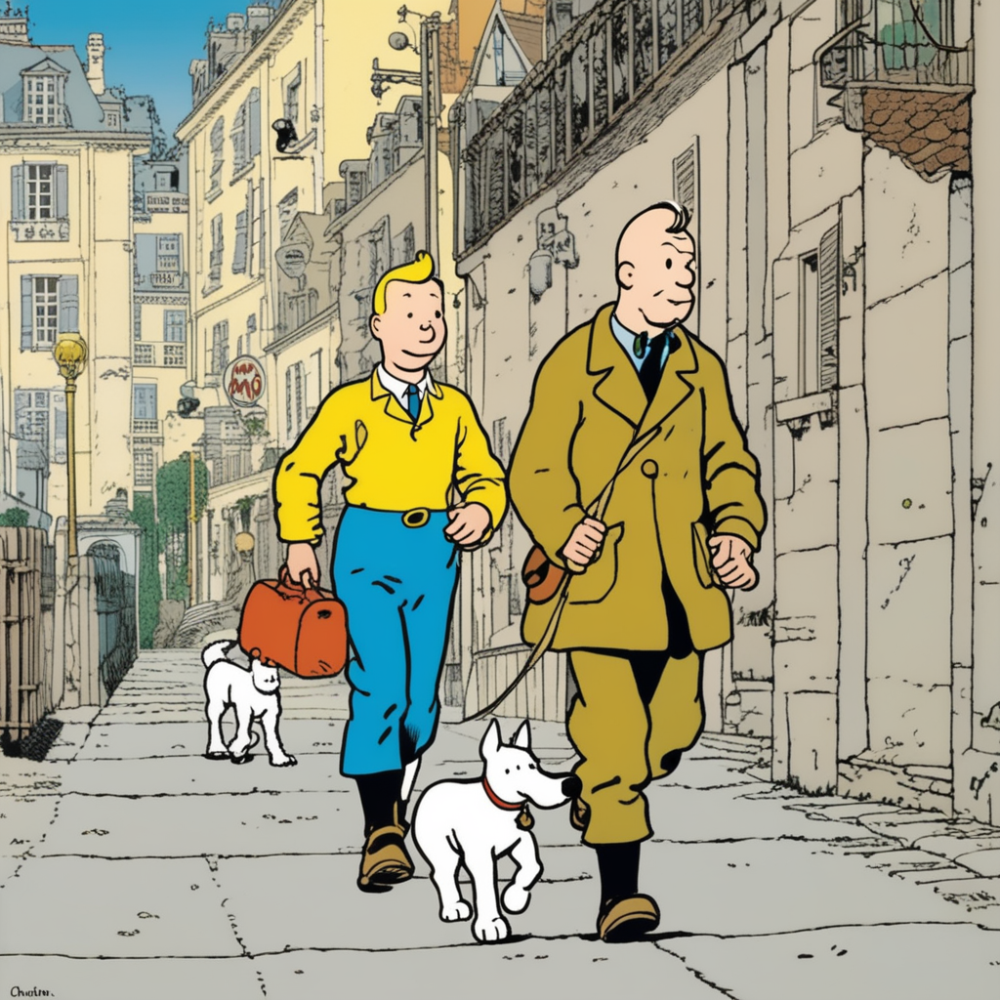

Generated 5 images for prompt:
  'tintin and snowy walking, ligne claire, herge'

Enter prompt (or 'exit' to quit): exiz


  0%|          | 0/50 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [3]:
# Simple SDXL Inference Script: Generate 5 Images per Prompt

# 1. Install required libraries
!pip install -q diffusers transformers accelerate safetensors

# 2. Imports
import torch
from diffusers import StableDiffusionXLPipeline, DPMSolverMultistepScheduler
from IPython.display import display

# 3. Pipeline Initialization
model_name = "stabilityai/stable-diffusion-xl-base-1.0"

device = "cuda" if torch.cuda.is_available() else "cpu"

pipeline = StableDiffusionXLPipeline.from_pretrained(
    model_name,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
# use the same scheduler as training
pipeline.scheduler = DPMSolverMultistepScheduler.from_pretrained(
    model_name,
    subfolder="scheduler"
)
pipeline = pipeline.to(device)

print("SDXL Inference ready on", device)

# 4. Interactive Loop
while True:
    prompt = input("Enter prompt (or 'exit' to quit): ")
    if not prompt or prompt.lower() in {"exit", "quit"}:
        print("Exiting.")
        break

    # Generate 5 images
    output = pipeline(
        prompt=prompt,
        num_images_per_prompt=5,
        guidance_scale=7.5,
    )

    for i, img in enumerate(output.images):
        display(img)
        img.save(f"sdxl_gen_{i}.png")

    print("Generated 5 images for prompt:\n  '" + prompt + "'\n")
